# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Standard Package Imports

In [1]:
# Import all the packages that might be needed
import os 

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import plotly.express as px
import plotly.graph_objs as go
import plotly.io as pio

import sklearn
print(sklearn.__version__)
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

from sklearn.preprocessing import OneHotEncoder
!pip install category_encoders
import category_encoders as ce

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

import statistics 
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.model_selection import train_test_split
import warnings

from sklearn.metrics import mean_squared_error
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf, plot_predict

from sklearn.cluster import KMeans

1.2.1


### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

Given a dataset containing 426,880 rows of data on used car sales, exploratory data analysis was done to clean the data, visualize the data and determine the strongest influencing features that drove the used car price.  Most of the data needed to be cleaned and the categorical data converted to some sort of encoded value. The feature being 'predicted' was the 'price' variable. The independent variables being assessed as influencing factors included region, year, manufacturer, model, condition, cylinders, fuel, odometer, title_status, transmission, drive, size, type, paint_color, and state.  The business question to answer is to understand which features of the used cars are most important for driving up the sales price and for the dealership to then know what to emphasize about the car during the sales process and which type of used cars to buy/stock. 

A used car sales lot manager wants to have as quick turnover as possible for the inventory and needs to decide which used cars to buy to fill the inventory.  Therefore, understanding which used cars sell at the higher prices is a good indicator for what to look for when stocking inventory for maximizing revenues.  Additionally, perhaps there are some types of used cars that the lot manager might not want to ever buy since they do not sell or they do not sell for high prices.  These are the types of trends that a data analysis might be able to uncover. 

In [2]:
#Import the data
vehicles = pd.read_csv('/Users/tinalount/Desktop/Data/Vehicles.csv')

In [3]:
vehicles.info()
vehicles.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

(426880, 18)

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

Note: this analysis data cleanup phase was approached with the eyes of a potential used sales car 'buyer' - what are the key things that I would rely on when making the decision about the used car (assuming the dealership has done all the repair and cleaning work to make the condition of the car feel as new as possible).  The key factors going into this analysis that were assumed to be a priority for buyers were: 
* color - buyers care about the color of their car
* manufacturer  - buyers have perceptions about the reliability of the manufacturers
* type - buyers are looking for certain 'types' of cars - suv, hatchback, etc as a key usage criteria 
* age - buyers care about the age of the car since it gives a sense of remaining 'life' of car 
* condition - buyers don't want poor condition cars even if they are used
* fuel - buyers are looking for electric or hybrid or gas fuel efficient cars
The data cleanup was approached with these top factors in mind, removing various columns that either had too many null values or too 'noisy' data that couldn't be imputed without domain knowledge. 

Further data cleanup to the original dataset is recommended - it has an issue with having too many null values everywhere -  if the 'drive' and 'type' 'transmission' 'cylinders' 'size' columns were filled out more completely in the future it would potentially lead to a much more accurate sales model. 

In [4]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [5]:
vehicles.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [6]:
# This dataset has a large number of missing data fields ('nan' values)

In [7]:
vehicles.tail()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,58ABK1GG4JU103853,fwd,NaN,sedan,silver,wy
426879,7301591129,wyoming,30590,2019.0,bmw,4 series 430i gran coupe,good,NaN,gas,22716.0,clean,other,WBA4J1C58KBM14708,rwd,NaN,coupe,NaN,wy


In [8]:
# Drop the 'id' 'state' and 'VIN' columns which do not contribute to anything related to the sales price of a car
vehicles.drop(columns = ['id', 'VIN', 'state'], inplace = True)

In [9]:
vehicles.columns

Index(['region', 'price', 'year', 'manufacturer', 'model', 'condition',
       'cylinders', 'fuel', 'odometer', 'title_status', 'transmission',
       'drive', 'size', 'type', 'paint_color'],
      dtype='object')

In [10]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        426880 non-null  object 
 1   price         426880 non-null  int64  
 2   year          425675 non-null  float64
 3   manufacturer  409234 non-null  object 
 4   model         421603 non-null  object 
 5   condition     252776 non-null  object 
 6   cylinders     249202 non-null  object 
 7   fuel          423867 non-null  object 
 8   odometer      422480 non-null  float64
 9   title_status  418638 non-null  object 
 10  transmission  424324 non-null  object 
 11  drive         296313 non-null  object 
 12  size          120519 non-null  object 
 13  type          334022 non-null  object 
 14  paint_color   296677 non-null  object 
dtypes: float64(2), int64(1), object(12)
memory usage: 48.9+ MB


In [11]:
#calculate the number of missing values in each column
vehicles.isnull().sum()

region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
drive           130567
size            306361
type             92858
paint_color     130203
dtype: int64

In [12]:
#Transform the datatypes to be more specific instead of "object"
vehicles = vehicles.convert_dtypes()

In [13]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        426880 non-null  string
 1   price         426880 non-null  Int64 
 2   year          425675 non-null  Int64 
 3   manufacturer  409234 non-null  string
 4   model         421603 non-null  string
 5   condition     252776 non-null  string
 6   cylinders     249202 non-null  string
 7   fuel          423867 non-null  string
 8   odometer      422480 non-null  Int64 
 9   title_status  418638 non-null  string
 10  transmission  424324 non-null  string
 11  drive         296313 non-null  string
 12  size          120519 non-null  string
 13  type          334022 non-null  string
 14  paint_color   296677 non-null  string
dtypes: Int64(3), string(12)
memory usage: 50.1 MB


In [14]:
# run describe on the data (gives summary for numerical values)
vehicles.describe()

,price,year,odometer
count,4.268800e+05,425675.000000,4.224800e+05
mean,7.519903e+04,2011.235191,9.804333e+04
std,1.218228e+07,9.452120,2.138815e+05
min,0.000000e+00,1900.000000,0.000000e+00
25%,5.900000e+03,2008.000000,3.770400e+04
50%,1.395000e+04,2013.000000,8.554800e+04
75%,2.648575e+04,2017.000000,1.335425e+05
max,3.736929e+09,2022.000000,1.000000e+07


In [15]:
# run describe for non-numeric values 
vehicles.describe(include = ['string'])

,region,manufacturer,model,condition,cylinders,fuel,title_status,transmission,drive,size,type,paint_color
count,426880,409234,421603,252776,249202,423867,418638,424324,296313,120519,334022,296677
unique,404,42,29649,6,8,5,6,3,3,4,13,12
top,columbus,ford,f-150,good,6 cylinders,gas,clean,automatic,4wd,full-size,sedan,white
freq,3608,70985,8009,121456,94169,356209,405117,336524,131904,63465,87056,79285


In [16]:
vehicles_nonulls = vehicles.dropna()
vehicles_nonulls.shape

(79195, 15)

In [17]:
# Dropping all the rows with null values would transform the dataset from 426880 rows to 79,195 rows


In [18]:
# Determine the number of records that have the value '0' 
vehicles.eq(0).sum()

region              0
price           32895
year                0
manufacturer        0
model               0
condition           0
cylinders           0
fuel                0
odometer         1965
title_status        0
transmission        0
drive               0
size                0
type                0
paint_color         0
dtype: int64

In [19]:
# 32,895 records have $0 price - that is not meaningful for a car to have $0 price - do drop those records! 
# 1965 records have 0 for the odometer - either tampered with or not driven

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [20]:
#Transform the datatypes to be more specific instead of "object"
vehicles_trans = vehicles.convert_dtypes()

In [21]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        426880 non-null  string
 1   price         426880 non-null  Int64 
 2   year          425675 non-null  Int64 
 3   manufacturer  409234 non-null  string
 4   model         421603 non-null  string
 5   condition     252776 non-null  string
 6   cylinders     249202 non-null  string
 7   fuel          423867 non-null  string
 8   odometer      422480 non-null  Int64 
 9   title_status  418638 non-null  string
 10  transmission  424324 non-null  string
 11  drive         296313 non-null  string
 12  size          120519 non-null  string
 13  type          334022 non-null  string
 14  paint_color   296677 non-null  string
dtypes: Int64(3), string(12)
memory usage: 50.1 MB


##### Transformation related to 'price' column

In [22]:
# Drop the rows that have $0 price which is not meaningful for the sales price predictions
vehicles_trans = vehicles_trans.dropna(subset=['price'])
vehicles_trans.shape

(426880, 15)

In [23]:
#calculate the number of missing values in each column - 'price' does not have any null values 
vehicles_trans.isnull().sum()

region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
drive           130567
size            306361
type             92858
paint_color     130203
dtype: int64

In [24]:
vehicles_trans.eq(0).sum()

region              0
price           32895
year                0
manufacturer        0
model               0
condition           0
cylinders           0
fuel                0
odometer         1965
title_status        0
transmission        0
drive               0
size                0
type                0
paint_color         0
dtype: int64

In [25]:
# Drop the rows that have $0 price which is not meaningful for the sales price predictions
vehicles_trans = vehicles_trans[vehicles_trans['price'] != 0].reset_index(drop=True)
vehicles_trans.shape

(393985, 15)

In [26]:
vehicles_trans.head()

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color
0,prescott,6000,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
1,fayetteville,11900,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
2,florida keys,21000,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
3,worcester / central MA,1500,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
4,greensboro,4900,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


In [27]:
# RECAP: 32,895 rows with $0 'price' values were dropped from dataset

##### Analyze the 'size' attribute 

In [28]:
# Analyze the 'size' variable:
vehicles_trans['size'].unique()


<StringArray>
[<NA>, 'full-size', 'mid-size', 'compact', 'sub-compact']
Length: 5, dtype: string

In [29]:
vehicles_trans['size'].nunique()

4

In [30]:
vehicles_trans.isnull().sum()

region               0
price                0
year              1173
manufacturer     16185
model             4701
condition       151389
cylinders       160410
fuel              2594
odometer          2290
title_status      7734
transmission      1823
drive           120254
size            282933
type             85932
paint_color     117149
dtype: int64

In [31]:
# In the raw dataset 306,361 rows have null size value! One option is to drop all the na values but that is too much
# Just drop the rows with null size value since of 426K rows 306K rows have null size columnn 
# Doesn't make sense to attempt to impute the values without specific domain knowledge 
# DECISION: drop the column 'size' for this analysis since the model will effectively capture this by taking into account 'model'
vehicles_trans = vehicles_trans.drop('size', axis=1)

In [32]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 393985 entries, 0 to 393984
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        393985 non-null  string
 1   price         393985 non-null  Int64 
 2   year          392812 non-null  Int64 
 3   manufacturer  377800 non-null  string
 4   model         389284 non-null  string
 5   condition     242596 non-null  string
 6   cylinders     233575 non-null  string
 7   fuel          391391 non-null  string
 8   odometer      391695 non-null  Int64 
 9   title_status  386251 non-null  string
 10  transmission  392162 non-null  string
 11  drive         273731 non-null  string
 12  type          308053 non-null  string
 13  paint_color   276836 non-null  string
dtypes: Int64(3), string(11)
memory usage: 43.2 MB


In [33]:
vehicles_trans.shape

(393985, 14)

In [34]:
# RECAP: the 'size' attribute was dropped from the dataset due to majority null values and covered by 'manufacturer'

##### Analyze the 'odometer' attribute 

In [35]:
# Review count of '0' values in each column
vehicles_trans.eq(0).sum()

region             0
price              0
year               0
manufacturer       0
model              0
condition          0
cylinders          0
fuel               0
odometer        1114
title_status       0
transmission       0
drive              0
type               0
paint_color        0
dtype: int64

In [36]:
# Drop rows with odometer = '0' (3404 more rows were dropped)
vehicles_trans = vehicles_trans[vehicles_trans['odometer'] != 0].reset_index(drop=True)
vehicles_trans.shape

(390581, 14)

In [37]:
# RECAP: 32,895 rows with $0 'odometer' values were dropped from dataset not knowing if this was trustworthy reading

In [38]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390581 entries, 0 to 390580
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        390581 non-null  string
 1   price         390581 non-null  Int64 
 2   year          389482 non-null  Int64 
 3   manufacturer  374714 non-null  string
 4   model         385965 non-null  string
 5   condition     240504 non-null  string
 6   cylinders     231815 non-null  string
 7   fuel          388295 non-null  string
 8   odometer      390581 non-null  Int64 
 9   title_status  383368 non-null  string
 10  transmission  389061 non-null  string
 11  drive         271277 non-null  string
 12  type          305431 non-null  string
 13  paint_color   274961 non-null  string
dtypes: Int64(3), string(11)
memory usage: 42.8 MB


##### Analyze the 'model' attribute 

In [39]:
vehicles_trans['model'].unique()

<StringArray>
[      'sierra 1500 crew cab slt',                 'silverado 1500',
            'silverado 1500 crew',           'tundra double cab sr',
                      'f-150 xlt',    'sierra 2500 hd extended cab',
          'silverado 1500 double',                         'tacoma',
          'colorado extended cab',           'corvette grand sport',
 ...
                     'cruze, 2lt',                        '2500 ls',
 'Thunder Creek Fuel Trailer MT2',                       '1500 z71',
                   'cj 3a willys',                  'rx& gls sport',
                            'ATI',                  'gand wagoneer',
                    '96 Suburban',        'Paige Glenbrook Touring']
Length: 27976, dtype: string

In [40]:
# the 'model' column has inconsistent values for the same model 'silverado 1500', 'silverado 1500 crew', etc. 
## without domain knowledge I don't know if these are the same car models or different? 
## the data isn't clean enough - could be better to go by manufacturer (see below)

In [41]:
# drop the 'model' attribute for this analysis
vehicles_trans = vehicles_trans.drop('model', axis=1)

In [42]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390581 entries, 0 to 390580
Data columns (total 13 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        390581 non-null  string
 1   price         390581 non-null  Int64 
 2   year          389482 non-null  Int64 
 3   manufacturer  374714 non-null  string
 4   condition     240504 non-null  string
 5   cylinders     231815 non-null  string
 6   fuel          388295 non-null  string
 7   odometer      390581 non-null  Int64 
 8   title_status  383368 non-null  string
 9   transmission  389061 non-null  string
 10  drive         271277 non-null  string
 11  type          305431 non-null  string
 12  paint_color   274961 non-null  string
dtypes: Int64(3), string(10)
memory usage: 39.9 MB


In [43]:
# RECAP: the 'model' column was too noisy and was dropped

##### Analyze the 'paint_color' attribute 

In [44]:
vehicles_trans['paint_color'].unique()

<StringArray>
[ 'white',   'blue',    'red',  'black', 'silver',   'grey',     <NA>,
  'brown', 'yellow', 'orange',  'green', 'custom', 'purple']
Length: 13, dtype: string

In [45]:
vehicles['paint_color'].nunique()

12

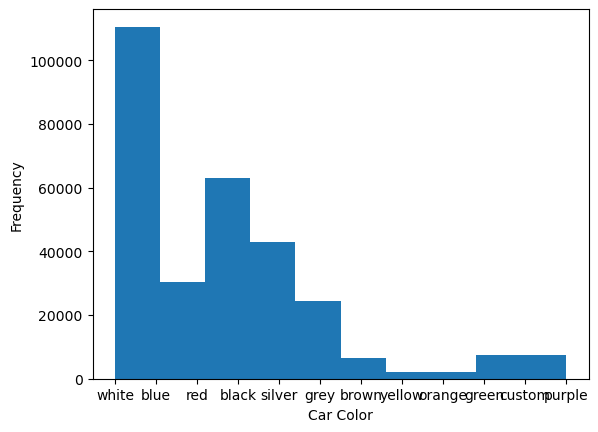

In [46]:
# Plot histogram of 'paint_color' column (from original dataframe)
plt.hist(vehicles['paint_color'].dropna())
plt.xlabel('Car Color')
plt.ylabel('Frequency')
plt.show()

RECAP: Most of the used cars in the dataset were white, followed black,then silver, blue, red, and grey 
big drop off to green, custom, brown, yellow, orange, purple

In [47]:
# Count number of cars sold by paint color in descending order
car_counts = vehicles['paint_color'].value_counts(sort=True, ascending=False)

# Print the result
print(car_counts)

white     79285
black     62861
silver    42970
blue      31223
red       30473
grey      24416
green      7343
custom     6700
brown      6593
yellow     2142
orange     1984
purple      687
Name: paint_color, dtype: Int64


In [48]:
vehicles_trans['paint_color'].isnull().sum()

115620

In [49]:
# Drop rows with no color value
vehicles_trans = vehicles_trans[vehicles_trans['paint_color'].notnull()].reset_index(drop=True)
vehicles_trans.shape

(274961, 13)

In [50]:
# Create OneHotEncoder object
ohe = OneHotEncoder(sparse_output=False)

# Encode paint_color column
color_encoded = ohe.fit_transform(vehicles_trans['paint_color'].values.reshape(-1, 1))
color_categories = ohe.categories_

# One-hot encode 'paint_color' column
color_ohe = pd.get_dummies(vehicles_trans['paint_color'], prefix='color')
vehicles_trans = pd.concat([vehicles_trans, color_ohe], axis=1)

# Drop original 'paint_color' column
vehicles_trans = vehicles_trans.drop('paint_color', axis=1)

In [51]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 274961 entries, 0 to 274960
Data columns (total 24 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   region        274961 non-null  string
 1   price         274961 non-null  Int64 
 2   year          273937 non-null  Int64 
 3   manufacturer  263991 non-null  string
 4   condition     191929 non-null  string
 5   cylinders     188169 non-null  string
 6   fuel          273298 non-null  string
 7   odometer      274961 non-null  Int64 
 8   title_status  273819 non-null  string
 9   transmission  273895 non-null  string
 10  drive         220326 non-null  string
 11  type          250039 non-null  string
 12  color_black   274961 non-null  uint8 
 13  color_blue    274961 non-null  uint8 
 14  color_brown   274961 non-null  uint8 
 15  color_custom  274961 non-null  uint8 
 16  color_green   274961 non-null  uint8 
 17  color_grey    274961 non-null  uint8 
 18  color_orange  274961 non

In [52]:
# RECAP: the 'paint_color' column was one-hot-encoded to create 12 boolean value columns from 1 column

##### Analyze the 'region' attribute 

In [53]:
vehicles['region'].unique()

<StringArray>
[              'prescott',           'fayetteville',           'florida keys',
 'worcester / central MA',             'greensboro',          'hudson valley',
        'medford-ashland',                   'erie',                'el paso',
             'bellingham',
 ...
             'eau claire',              'green bay',             'janesville',
         'kenosha-racine',                'madison',              'milwaukee',
            'northern WI',              'sheboygan',                 'wausau',
                'wyoming']
Length: 404, dtype: string

In [54]:
# Drop 'region' column
vehicles_trans = vehicles_trans.drop('region', axis=1)

In [55]:
#RECAP: the 'region' column was dropped due to 404 different values and inconsistent naming, etc

##### Analyze the 'year' attribute 

In [56]:
vehicles['region'].unique()

<StringArray>
[              'prescott',           'fayetteville',           'florida keys',
 'worcester / central MA',             'greensboro',          'hudson valley',
        'medford-ashland',                   'erie',                'el paso',
             'bellingham',
 ...
             'eau claire',              'green bay',             'janesville',
         'kenosha-racine',                'madison',              'milwaukee',
            'northern WI',              'sheboygan',                 'wausau',
                'wyoming']
Length: 404, dtype: string

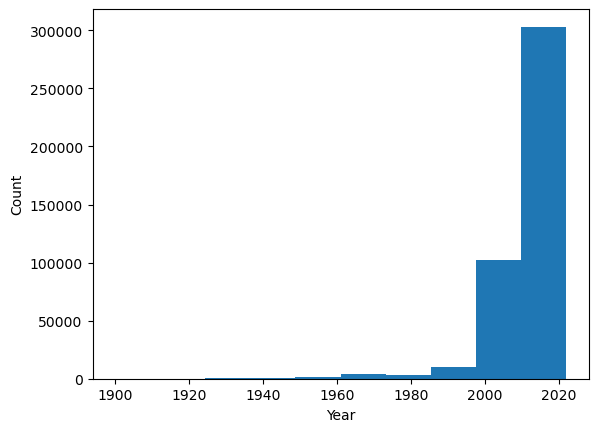

In [57]:
# Plot histogram of 'year' column (from original dataframe)
plt.hist(vehicles['year'].dropna())
plt.xlabel('Year')
plt.ylabel('Count')
plt.show()

In [58]:
# Transform 'year' to 'age' 
# calculate age of vehicle
vehicles_trans['age'] = 2023 - vehicles_trans['year']

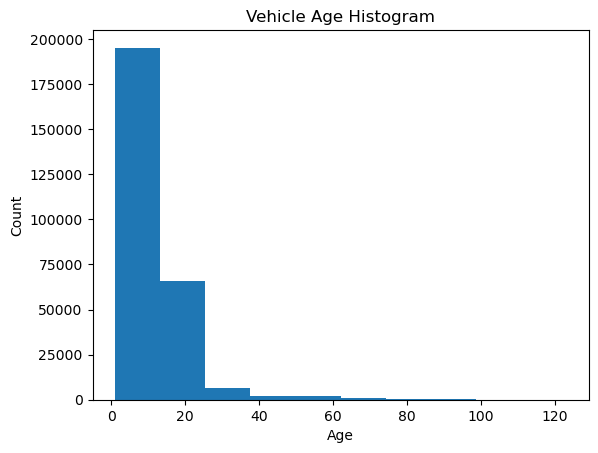

In [59]:
# Plot histogram of 'year' column (from original dataframe)
plt.hist(vehicles_trans['age'].dropna())
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Vehicle Age Histogram')
plt.show()

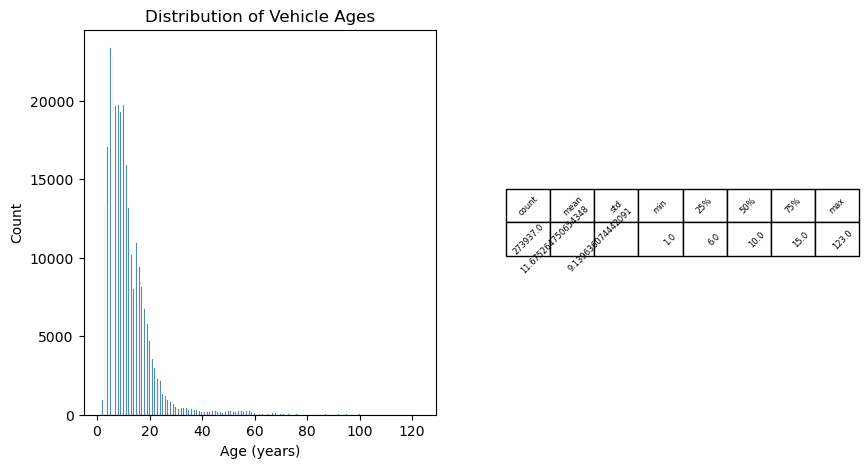

In [60]:
# create a grid of plots
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10,5))

# plot histogram of age column with seaborn
sns.histplot(data=vehicles_trans, x='age', ax=ax1)

# add chart title
ax1.set_title("Distribution of Vehicle Ages")

# add x-axis label
ax1.set_xlabel("Age (years)")

# add y-axis label
ax1.set_ylabel("Count")

# add chart table
table_data = vehicles_trans["age"].describe()
table2 = ax2.table(cellText=[table_data], 
                  colLabels=table_data.index, 
                  loc="center")
table2.auto_set_font_size(False)
table2.set_fontsize(6)

# set text rotation for each cell in the table
for cell in table2.get_celld().values():
    cell._text.set_rotation(45)
    
table2.scale(1, 2)


# remove axis ticks and labels from second subplot
ax2.axis("off")

plt.show()


RECAP: most used cars sold were 5 years old (123 in the remaining dataset)
NOTE: A quick google search reveals: "Overall, researchers find that the average age of used cars people are seeking is 6.47 years old."
The MEAN is 11.6 years old with a std dev of 9.2 years and 

In [61]:
#Dump rows that have n/a for calculated age 
vehicles_trans = vehicles_trans.dropna(subset=['age'])

In [62]:
vehicles_trans.shape

(273937, 24)

In [63]:
# Count number of cars sold by paint color in descending order
car_age = vehicles_trans['age'].value_counts(sort=True, ascending=False)

# Print the result
print(car_age)

5      23367
6      22808
10     19728
8      19728
7      19667
       ...  
122        1
118        1
105        1
114        1
103        1
Name: age, Length: 110, dtype: Int64


In [64]:
# combine all values with '1' count into a single slice
age_counts = vehicles_trans['age'].value_counts()
age_counts.loc[age_counts == 1] = age_counts.loc[age_counts.isin([1, 2, 3])].sum()
age_counts = age_counts.drop(labels=[2, 3])

# replace values of 1 in age column with '1-2 years'
vehicles_trans['age'] = vehicles_trans['age'].replace(1, 1)

#plt.figure(figsize=(6,6))
#plt.title('Car Age Distribution', fontsize=12)

# calculate percentages
age_pct = age_counts / age_counts.sum()
# create a Pie chart and remove labels for slices less than 1%
labels = age_pct[age_pct >= 0.01].index.tolist()
values = age_pct[age_pct >= 0.01].values.tolist()

textinfo = 'percent'
if len(age_pct[age_pct >= 0.01]) == 1:
    # If only one slice is greater than 1%, show the labels
    textinfo = 'label+percent'

# create a Pie chart using Plotly
#fig = go.Figure(data=[go.Pie(labels=vehicles_trans['age'].value_counts().index.tolist(), 
#values=vehicles_trans['age'].value_counts().values.tolist())])
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hoverinfo='label+percent', textinfo=textinfo)])

# set the title of the chart
fig.update_layout(title_text='Car Age Distribution')

# set the title of the chart and legend
fig.update_layout(
    title_text='Car Age Distribution',
    legend_title='Car\'s Age'
)

# show the chart
fig.show()

# save the figure as a jpg
pio.write_image(fig, 'Car Age PieChart.jpg')

In [65]:
#Drop the Year column now that we have 'Age'
vehicles_trans = vehicles_trans.drop('year', axis=1)

RECAP:9.9% of the sold used cars were 5 years old, 9.6% were 6 years old, 8.2% were 8 and 10 years, and 8% were 9 and 7 years old. Very few used cars sold were under 3 years old! So majority sold were 5-10 years old! This definitely seems like Car Age will be a key influencing variable. 

##### Analyze the 'manufacturer' attribute 

In [66]:
vehicles_trans['manufacturer'].unique()

<StringArray>
[            'gmc',       'chevrolet',          'toyota',            'ford',
            'jeep',          'nissan',             'ram',        'cadillac',
           'honda',           'dodge',           'lexus',          'jaguar',
           'buick',        'chrysler',           'volvo',        'infiniti',
         'lincoln',              <NA>,           'acura',         'hyundai',
   'mercedes-benz',            'audi',             'bmw',      'mitsubishi',
          'subaru',      'alfa-romeo',      'volkswagen',           'mazda',
         'porsche',             'kia',           'rover',         'ferrari',
            'mini',         'pontiac',            'fiat',           'tesla',
          'saturn',         'mercury', 'harley-davidson',          'datsun',
    'aston-martin',      'land rover',          'morgan']
Length: 43, dtype: string

In [67]:
vehicles_trans['manufacturer'].nunique()

42

In [68]:
manufacturer_counts = vehicles_trans['manufacturer'].value_counts()
print(manufacturer_counts)

ford               45489
chevrolet          35047
toyota             22389
honda              13934
nissan             12383
jeep               11962
ram                10710
gmc                10541
bmw                10069
dodge               8316
mercedes-benz       7674
hyundai             6747
volkswagen          6553
subaru              6346
lexus               5417
kia                 5256
audi                5210
cadillac            4623
acura               4095
chrysler            3630
buick               3480
mazda               3430
infiniti            3242
lincoln             2768
mitsubishi          2363
volvo               2113
mini                1679
jaguar              1467
pontiac             1418
rover               1373
porsche              851
mercury              733
alfa-romeo           681
saturn               679
tesla                637
fiat                 467
harley-davidson      104
ferrari               49
datsun                38
aston-martin          13


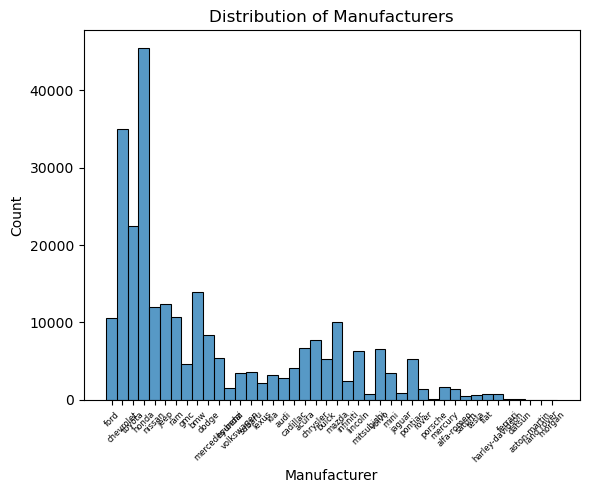

In [69]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# count the manufacturers and plot a histogram
#sns.histplot(data=vehicles_trans, x="manufacturer")

manufacturer_counts = vehicles_trans['manufacturer'].value_counts()
fig, ax = plt.subplots()
sns.histplot(data=vehicles_trans, x='manufacturer', ax=ax)
ax.set_title("Distribution of Manufacturers")
ax.set_xlabel("Manufacturer")
ax.set_ylabel("Count")
ax.set_xticklabels(manufacturer_counts.index, rotation=45, size=6)
plt.show()

In [70]:
print(vehicles_trans.isna().sum())

price               0
manufacturer     9950
condition       82008
cylinders       86787
fuel             1483
odometer            0
title_status      927
transmission     1066
drive           54424
type            24813
color_black         0
color_blue          0
color_brown         0
color_custom        0
color_green         0
color_grey          0
color_orange        0
color_purple        0
color_red           0
color_silver        0
color_white         0
color_yellow        0
age                 0
dtype: int64


In [71]:
#Dump rows that have no manufacturer listed
vehicles_trans = vehicles_trans.dropna(subset=['manufacturer'])

In [72]:
vehicles_trans.shape

(263987, 23)

In [73]:
# graph using plotly

import plotly.express as px

# Count the number of occurrences of each manufacturer
manufacturer_counts = vehicles_trans['manufacturer'].value_counts()

# Sort the counts in descending order
manufacturer_counts_sorted = manufacturer_counts.sort_values(ascending=False)

# Create a histogram
fig = px.histogram(vehicles_trans, x='manufacturer', category_orders={'manufacturer': manufacturer_counts.index})

fig.update_layout(
    title='Distribution of Manufacturers',
    xaxis_title='Manufacturer',
    yaxis_title='Count'
)
fig.update_layout(xaxis={'tickangle': 45})

fig.show()

# save the figure as a jpg
pio.write_image(fig, 'manufacturer_histogram.jpg')

Since this is a general used car dealership - focus on 24 COMMON MANUFACTURING BRANDS of USED CAR SALES - drop the rows of sales for the manufacturers that counted for less than 1000 rows of sales (uncommon used cars - fiat, alfa-romeo, harley-davidson, ferrari, land rover, tesla, aston-martin, mnorgan)

In [74]:
# Compute count of sales for each manufacturer
manufacturer_counts = vehicles_trans['manufacturer'].value_counts()

# Get list of manufacturers with more than 1000 sales
top_manufacturers = manufacturer_counts[manufacturer_counts >= 1000].index.tolist()

# Filter dataframe to only include rows with top manufacturers
vehicles_trans = vehicles_trans[vehicles_trans['manufacturer'].isin(top_manufacturers)]

In [75]:
# graph using plotly

import plotly.express as px

# Count the number of occurrences of each manufacturer
manufacturer_counts = vehicles_trans['manufacturer'].value_counts()

# Sort the counts in descending order
manufacturer_counts_sorted = manufacturer_counts.sort_values(ascending=False)

# Create a histogram
fig = px.histogram(vehicles_trans, x='manufacturer', category_orders={'manufacturer': manufacturer_counts.index})

fig.update_layout(
    title='Distribution of Manufacturers',
    xaxis_title='Manufacturer',
    yaxis_title='Count'
)
fig.update_layout(xaxis={'tickangle': 45})

fig.show()

# save the figure as a jpg
pio.write_image(fig, 'manufacturer_histogram2.jpg')

In [76]:
# ENCODE THE TOP MANUFACTURERS WITH ONE HOT ENCODING
# Create OneHotEncoder object
manu_ohe = OneHotEncoder(sparse_output=False)

# Encode paint_color column
manu_encoded = manu_ohe.fit_transform(vehicles_trans['manufacturer'].values.reshape(-1, 1))
manu_categories = manu_ohe.categories_

# One-hot encode top 'manufacturers' column
manu_ohe = pd.get_dummies(vehicles_trans['manufacturer'], prefix='manu_')
vehicles_trans = pd.concat([vehicles_trans, manu_ohe], axis=1)

# Drop original 'manufacturer' column
vehicles_trans = vehicles_trans.drop('manufacturer', axis=1)

In [77]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 259724 entries, 0 to 274960
Data columns (total 52 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   price                259724 non-null  Int64 
 1   condition            179999 non-null  string
 2   cylinders            177887 non-null  string
 3   fuel                 258327 non-null  string
 4   odometer             259724 non-null  Int64 
 5   title_status         258848 non-null  string
 6   transmission         258724 non-null  string
 7   drive                208680 non-null  string
 8   type                 236798 non-null  string
 9   color_black          259724 non-null  uint8 
 10  color_blue           259724 non-null  uint8 
 11  color_brown          259724 non-null  uint8 
 12  color_custom         259724 non-null  uint8 
 13  color_green          259724 non-null  uint8 
 14  color_grey           259724 non-null  uint8 
 15  color_orange         259724 non-nu

In [78]:
# get the current working directory
cwd = os.getcwd()
print(f"Current working directory: {cwd}")

Current working directory: /Users/tinalount/Desktop


##### Analyze the 'condition' attribute 

In [79]:
vehicles_trans['condition'].unique()

<StringArray>
['good', 'excellent', 'like new', 'new', <NA>, 'fair', 'salvage']
Length: 7, dtype: string

In [80]:
vehicles_trans['condition'].nunique()

6

In [81]:
condition_counts = vehicles_trans['condition'].value_counts()
print(condition_counts)

good         92889
excellent    65984
like new     14955
fair          4974
new            774
salvage        423
Name: condition, dtype: Int64


condition has 80569 nulls so just put in 'unknown as a value for modeling'
DECISION TO DROP null rows of condition - future analysis should collect this data - assumption is the dealership can repair and clean up to make like new 

In [82]:
#Dump rows that have no manufacturer listed
vehicles_trans = vehicles_trans.dropna(subset=['condition'])

In [83]:
condition_counts = vehicles_trans['condition'].value_counts()
print(condition_counts)

good         92889
excellent    65984
like new     14955
fair          4974
new            774
salvage        423
Name: condition, dtype: Int64


In [84]:
# Define dictionary mapping condition strings to integers
condition_dict = {'new': 1, 'like new': 3, 'excellent': 2, 'good': 4, 'fair': 5, 'salvage': 6}

# Create new column 'condition_int' by mapping values in 'condition' column to integers
vehicles_trans['condition_int'] = vehicles_trans['condition'].map(condition_dict)


In [85]:
# convert the 'condition_int' column to numeric data type
vehicles_trans['condition_int'] = pd.to_numeric(vehicles_trans['condition_int'], errors='coerce')

In [86]:
# drop the string 'condition' column now that's its been encoded for this analysis
vehicles_trans = vehicles_trans.drop('condition', axis=1)

In [87]:
vehicles_trans.columns

Index(['price', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'drive', 'type', 'color_black', 'color_blue',
       'color_brown', 'color_custom', 'color_green', 'color_grey',
       'color_orange', 'color_purple', 'color_red', 'color_silver',
       'color_white', 'color_yellow', 'age', 'manu__acura', 'manu__audi',
       'manu__bmw', 'manu__buick', 'manu__cadillac', 'manu__chevrolet',
       'manu__chrysler', 'manu__dodge', 'manu__ford', 'manu__gmc',
       'manu__honda', 'manu__hyundai', 'manu__infiniti', 'manu__jaguar',
       'manu__jeep', 'manu__kia', 'manu__lexus', 'manu__lincoln',
       'manu__mazda', 'manu__mercedes-benz', 'manu__mini', 'manu__mitsubishi',
       'manu__nissan', 'manu__pontiac', 'manu__ram', 'manu__rover',
       'manu__subaru', 'manu__toyota', 'manu__volkswagen', 'manu__volvo',
       'condition_int'],
      dtype='object')

In [88]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 179999 entries, 0 to 274960
Data columns (total 52 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   price                179999 non-null  Int64 
 1   cylinders            135526 non-null  string
 2   fuel                 179983 non-null  string
 3   odometer             179999 non-null  Int64 
 4   title_status         179999 non-null  string
 5   transmission         179980 non-null  string
 6   drive                145380 non-null  string
 7   type                 165490 non-null  string
 8   color_black          179999 non-null  uint8 
 9   color_blue           179999 non-null  uint8 
 10  color_brown          179999 non-null  uint8 
 11  color_custom         179999 non-null  uint8 
 12  color_green          179999 non-null  uint8 
 13  color_grey           179999 non-null  uint8 
 14  color_orange         179999 non-null  uint8 
 15  color_purple         179999 non-nu

##### Analyze the 'cylinders' attribute 

In [89]:
vehicles_trans['cylinders'].unique()

<StringArray>
[ '8 cylinders',  '6 cylinders',           <NA>,  '4 cylinders',
  '5 cylinders', '10 cylinders',  '3 cylinders',        'other',
 '12 cylinders']
Length: 9, dtype: string

In [90]:
vehicles_trans['cylinders'].nunique()

8

In [91]:
cylinders_counts = vehicles_trans['cylinders'].value_counts()
print(cylinders_counts)

6 cylinders     52687
8 cylinders     40565
4 cylinders     39597
5 cylinders      1040
10 cylinders      982
other             317
3 cylinders       273
12 cylinders       65
Name: cylinders, dtype: Int64


In [92]:
import re
# define dictionary mapping string values to integers
cylinder_dict = {'3 cylinders':3, '4 cylinders': 4, '5 cylinders': 5, '6 cylinders': 6, '8 cylinders': 8, 
                 '10 cylinders': 10, '12 cylinders': 12, 'other': None}

# create a new column 'cylinders_int' with default value as None
vehicles_trans['cylinders_int'] = None

# iterate over each key-value pair in the cylinder_dict and fill corresponding integer values in the 'cylinders_int' column
for k, v in cylinder_dict.items():
    vehicles_trans.loc[vehicles_trans['cylinders'] == k, 'cylinders_int'] = v

# convert the 'cylinders_int' column to numeric data type
vehicles_trans['cylinders_int'] = pd.to_numeric(vehicles_trans['cylinders_int'], errors='coerce')

In [93]:
print(vehicles_trans['cylinders_int'])

0         8.0
1         8.0
2         8.0
3         8.0
4         6.0
         ... 
274956    NaN
274957    6.0
274958    NaN
274959    NaN
274960    6.0
Name: cylinders_int, Length: 179999, dtype: float64


In [94]:
vehicles_trans['cylinders_int'].isnull().sum()
#Dump rows that have n/a for cylinders_int
vehicles_trans = vehicles_trans.dropna(subset=['cylinders_int'])
vehicles_trans['cylinders_int'].isnull().sum()

0

In [95]:
# Drop 'cylinders' column
vehicles_trans = vehicles_trans.drop('cylinders', axis=1)

In [96]:
#cast 'cylinders_int' column as an integer column
vehicles_trans['cylinders_int'] = vehicles_trans['cylinders_int'].astype(int)

#RECAP: the 'cylinders' column was converted to an integer column matching the # of cylinders and the null rows were dropped

In [97]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 135209 entries, 0 to 274960
Data columns (total 52 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   price                135209 non-null  Int64 
 1   fuel                 135209 non-null  string
 2   odometer             135209 non-null  Int64 
 3   title_status         135209 non-null  string
 4   transmission         135202 non-null  string
 5   drive                119067 non-null  string
 6   type                 124843 non-null  string
 7   color_black          135209 non-null  uint8 
 8   color_blue           135209 non-null  uint8 
 9   color_brown          135209 non-null  uint8 
 10  color_custom         135209 non-null  uint8 
 11  color_green          135209 non-null  uint8 
 12  color_grey           135209 non-null  uint8 
 13  color_orange         135209 non-null  uint8 
 14  color_purple         135209 non-null  uint8 
 15  color_red            135209 non-nu

##### Analyze the 'fuel' attribute 

In [98]:
vehicles_trans['fuel'].unique()

<StringArray>
['gas', 'diesel', 'other', 'hybrid', 'electric']
Length: 5, dtype: string

In [99]:
vehicles_trans['fuel'].nunique()

5

In [100]:
fuel_counts = vehicles_trans['fuel'].value_counts()
print(fuel_counts)

gas         123911
diesel        7033
other         2683
hybrid        1506
electric        76
Name: fuel, dtype: Int64


In [101]:
# fuel only has 1410 null records so drop those rows since this is an important sales factor 
vehicles_trans = vehicles_trans.dropna(subset=['fuel'])

In [102]:
# Create OneHotEncoder object
fuel_ohe = OneHotEncoder(sparse_output=False)

# Encode paint_color column
fuel_encoded = ohe.fit_transform(vehicles_trans['fuel'].values.reshape(-1, 1))
fuel_categories = ohe.categories_

# One-hot encode 'paint_color' column
fuel_ohe = pd.get_dummies(vehicles_trans['fuel'], prefix='fuel')
vehicles_trans = pd.concat([vehicles_trans, fuel_ohe], axis=1)

# Drop original 'paint_color' column
vehicles_trans = vehicles_trans.drop('fuel', axis=1)

In [103]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 135209 entries, 0 to 274960
Data columns (total 56 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   price                135209 non-null  Int64 
 1   odometer             135209 non-null  Int64 
 2   title_status         135209 non-null  string
 3   transmission         135202 non-null  string
 4   drive                119067 non-null  string
 5   type                 124843 non-null  string
 6   color_black          135209 non-null  uint8 
 7   color_blue           135209 non-null  uint8 
 8   color_brown          135209 non-null  uint8 
 9   color_custom         135209 non-null  uint8 
 10  color_green          135209 non-null  uint8 
 11  color_grey           135209 non-null  uint8 
 12  color_orange         135209 non-null  uint8 
 13  color_purple         135209 non-null  uint8 
 14  color_red            135209 non-null  uint8 
 15  color_silver         135209 non-nu

##### Analyze the 'transmission' attribute 

In [104]:
vehicles_trans['transmission'].unique()

<StringArray>
['other', 'automatic', 'manual', <NA>]
Length: 4, dtype: string

In [105]:
vehicles_trans['transmission'].nunique()

3

In [106]:
transmission_counts = vehicles_trans['transmission'].value_counts()
print(transmission_counts)

automatic    106303
other         19488
manual         9411
Name: transmission, dtype: Int64


In [107]:
# transmission  only has   1034 so drop those rows
vehicles_trans = vehicles_trans.dropna(subset=['transmission'])

In [108]:
print(vehicles_trans.isna().sum())

price                      0
odometer                   0
title_status               0
transmission               0
drive                  16142
type                   10366
color_black                0
color_blue                 0
color_brown                0
color_custom               0
color_green                0
color_grey                 0
color_orange               0
color_purple               0
color_red                  0
color_silver               0
color_white                0
color_yellow               0
age                        0
manu__acura                0
manu__audi                 0
manu__bmw                  0
manu__buick                0
manu__cadillac             0
manu__chevrolet            0
manu__chrysler             0
manu__dodge                0
manu__ford                 0
manu__gmc                  0
manu__honda                0
manu__hyundai              0
manu__infiniti             0
manu__jaguar               0
manu__jeep                 0
manu__kia     

In [109]:
#Encode 'transmission' column into a boolean indicator whether car is automatic or not
# AUTOMATIC = 0, OTHER/MANUAL = 1
vehicles_trans['transmission_bool'] = vehicles_trans['transmission'].map(lambda x: 0 if x == 'automatic' else 1)
vehicles_trans.head()

,price,odometer,title_status,transmission,drive,type,color_black,color_blue,color_brown,color_custom,...,manu__volkswagen,manu__volvo,condition_int,cylinders_int,fuel_diesel,fuel_electric,fuel_gas,fuel_hybrid,fuel_other,transmission_bool
0,33590,57923,clean,other,<NA>,pickup,0,0,0,0,...,0,0,4,8,0,0,1,0,0,1
1,22590,71229,clean,other,<NA>,pickup,0,1,0,0,...,0,0,4,8,0,0,1,0,0,1
2,39590,19160,clean,other,<NA>,pickup,0,0,0,0,...,0,0,4,8,0,0,1,0,0,1
3,30990,41124,clean,other,<NA>,pickup,0,0,0,0,...,0,0,4,8,0,0,1,0,0,1
4,15000,128000,clean,automatic,rwd,truck,1,0,0,0,...,0,0,2,6,0,0,1,0,0,0


In [110]:
# Drop original Transmission column
vehicles_trans = vehicles_trans.drop('transmission', axis=1)

RECAP:  transmission column had the null value rows dropped due to low # of them and then was encoded into a boolean column indicating whether it is an automatic (0) or not (1)

##### Analyze the 'title_status' attribute 

In [111]:
vehicles_trans['title_status'].unique()


<StringArray>
['clean', 'rebuilt', 'lien', 'salvage', 'missing', 'parts only']
Length: 6, dtype: string

In [112]:
vehicles_trans['title_status'].nunique()

6

In [113]:
title_counts = vehicles_trans['title_status'].value_counts()
print(title_counts)

clean         128045
rebuilt         4040
salvage         1792
lien            1008
missing          258
parts only        59
Name: title_status, dtype: Int64


In [114]:
#title_status only has   890 null rows so drop those rows
#vehicles_trans = vehicles_trans.dropna(subset=['title_status'])

In [115]:
# instead of dropping the rows dropped the column 
vehicles_trans = vehicles_trans.drop('title_status', axis=1)

In [116]:
#RECAP: dropped the 'title_status' column since it's captured by 'condition' 

##### Analyze the 'type' attribute 

In [117]:
vehicles_trans['type'].unique()

<StringArray>
[     'pickup',       'truck',       'other',       'coupe',    'mini-van',
         'SUV',       'sedan',     'offroad', 'convertible',          <NA>,
   'hatchback',       'wagon',         'van',         'bus']
Length: 14, dtype: string

In [118]:
vehicles_trans['type'].nunique()

13

In [119]:
type_counts = vehicles_trans['type'].value_counts()
print(type_counts)

sedan          32272
SUV            28382
pickup         17049
truck          15212
coupe           8605
other           5651
hatchback       4406
van             3556
convertible     3278
wagon           3001
mini-van        2761
offroad          491
bus              172
Name: type, dtype: Int64


In [120]:
# type has 52,208 null values but this is a key value that I can't impute without domain knowledge so dropping


In [121]:
vehicles_trans = vehicles_trans.dropna(subset=['type'])

In [122]:
# One-Hot-Encode Type into boolean columns by type 
# Create OneHotEncoder object for type
type_ohe = OneHotEncoder(sparse_output=False)

# Encode type column
type_encoded = type_ohe.fit_transform(vehicles_trans['type'].values.reshape(-1, 1))
type_categories = type_ohe.categories_

# One-hot encode type column
type_ohe = pd.get_dummies(vehicles_trans['type'], prefix='type')
vehicles_trans = pd.concat([vehicles_trans, type_ohe], axis=1)

# Drop original 'type column
vehicles_trans = vehicles_trans.drop('type', axis=1)

In [123]:
print(vehicles_trans.isna().sum())


price              0
odometer           0
drive          14115
color_black        0
color_blue         0
               ...  
type_pickup        0
type_sedan         0
type_truck         0
type_van           0
type_wagon         0
Length: 67, dtype: int64


##### Analyze the 'drive' attribute 

In [124]:
vehicles_trans['drive'].unique()

<StringArray>
[<NA>, 'rwd', '4wd', 'fwd']
Length: 4, dtype: string

In [125]:
vehicles_trans['drive'].nunique()

3

In [126]:
# drive has 23,261 null values so IMPUTE nulls so impute values from 'type' - drop drive for now but in future
# analysis add this to see if it makes a difference (for example, pickup will have 'drive' information within it)
vehicles_trans = vehicles_trans.drop('drive', axis=1)

In [127]:
#RECAP: dropped the drive column since cocvered by 'type'

#### Summary of Finalized Transformed Dataset for Modeling

In [128]:
vehicles_trans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 124836 entries, 0 to 274960
Data columns (total 66 columns):
 #   Column               Non-Null Count   Dtype
---  ------               --------------   -----
 0   price                124836 non-null  Int64
 1   odometer             124836 non-null  Int64
 2   color_black          124836 non-null  uint8
 3   color_blue           124836 non-null  uint8
 4   color_brown          124836 non-null  uint8
 5   color_custom         124836 non-null  uint8
 6   color_green          124836 non-null  uint8
 7   color_grey           124836 non-null  uint8
 8   color_orange         124836 non-null  uint8
 9   color_purple         124836 non-null  uint8
 10  color_red            124836 non-null  uint8
 11  color_silver         124836 non-null  uint8
 12  color_white          124836 non-null  uint8
 13  color_yellow         124836 non-null  uint8
 14  age                  124836 non-null  Int64
 15  manu__acura          124836 non-null  uint8
 16  ma

In [129]:
vehicles_trans.shape

(124836, 66)

In [130]:
print(vehicles_trans.isna().sum())

price          0
odometer       0
color_black    0
color_blue     0
color_brown    0
              ..
type_pickup    0
type_sedan     0
type_truck     0
type_van       0
type_wagon     0
Length: 66, dtype: int64


## VISUALIZATIONS 


###### Correlation Matrix: 

In [131]:
# take a snapshot of the dataset so far for visualization
#graph_vehicles = vehicles_trans.copy()
# Identify numeric columns
#numeric_cols = graph_vehicles.select_dtypes(include=np.number).columns
# Create correlation matrix
#corr_matrix = graph_vehicles[numeric_cols].corr()
#sns.heatmap(corr_matrix, cmap='coolwarm', annot=True, vmin=-1, vmax=1)

From the Correlation Matrix for the numeric values:
** as the Year goes up (newer car), the odometer reading goes down. 
** as year goes up price slightly goes down? 
** as odometer goes up price slightly goes up? 
RECAP: Surprisingly not showing much of a correlation between price and year and odometer 

In [132]:

# Create a correlation matrix
corr_matrix = vehicles_trans.corr()

# Create a heatmap figure using Plotly
fig = go.Figure(
    data=go.Heatmap(
        z=corr_matrix.values,
        x=corr_matrix.columns,
        y=corr_matrix.index,
        colorscale='Viridis',
        colorbar=dict(title='Correlation')
    )
)

# Update the layout
fig.update_layout(
    title='Correlation Heatmap',
    xaxis=dict(title='Columns'),
    yaxis=dict(title='Columns')
)

# Display the figure
fig.show()

In [133]:
# Group columns by common prefix
columns_by_prefix = {}
for col in vehicles_trans.columns:
    prefix = col.split('_')[0]
    if prefix in columns_by_prefix:
        columns_by_prefix[prefix].append(col)
    else:
        columns_by_prefix[prefix] = [col]

# Create four separate heatmaps based on column groups
for prefix in ['manu', 'color', 'fuel', 'type']:
    if prefix in columns_by_prefix:
        data_cols = [col for col in columns_by_prefix[prefix] if col != 'price']
        data = vehicles_trans[['price'] + data_cols]
        corr_matrix = data.corr()
        fig = go.Figure(
            data=go.Heatmap(
                z=corr_matrix.values,
                x=corr_matrix.columns,
                y=corr_matrix.index,
                colorscale='Viridis',
                colorbar=dict(title='Correlation'),
                text=corr_matrix.round(2).values,
                hovertemplate='<b>Correlation: %{text}</b><extra></extra>'
            )
        )
        fig.update_layout(
            title=f'Correlation Heatmap: {prefix.capitalize()} Columns vs Price',
            xaxis=dict(title='Columns'),
            yaxis=dict(title='Columns')
        )
        fig.show()
       # Save the heatmaps as JPG files
        filename = f'{prefix}_heatmap.jpg'
        filepath = os.path.join(os.getcwd(), filename)
        fig.write_image(filepath)
        
    
        

In [134]:
# Select columns for 'other' heatmap
other_cols = ['price', 'age', 'odometer', 'condition_int', 'cylinders_int', 'transmission_bool']
other_data = vehicles_trans[other_cols]
corr_matrix = other_data.corr()

# Create heatmap
fig = go.Figure(
    data=go.Heatmap(
        z=corr_matrix.values,
        x=corr_matrix.columns,
        y=corr_matrix.index,
        colorscale='Viridis',
        colorbar=dict(title='Correlation'),
        text=corr_matrix.round(2).values,
        hovertemplate='<b>Correlation: %{text}</b><extra></extra>'
    )
)
fig.update_layout(
    title='Correlation Heatmap: Price, Age, Odometer, Condition, Cylinders, Transmission',
    xaxis=dict(title='Columns'),
    yaxis=dict(title='Columns')
)
fig.show()
# Save the heatmap as a jpg file
filename = 'other_heatmap.jpg'
filepath = os.path.join(os.getcwd(), filename)
fig.write_image(filepath)


CAUTION: Unfortunately these correlation maps do not show a lot of correlation between price and the other values so this is a signal of concern going into the modeling phase! 

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

## BASELINE MODEL 

In [135]:
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, GridSearchCV

### Baseline Linear Regression - Investigation

In [136]:
vehicles_trans.columns

Index(['price', 'odometer', 'color_black', 'color_blue', 'color_brown',
       'color_custom', 'color_green', 'color_grey', 'color_orange',
       'color_purple', 'color_red', 'color_silver', 'color_white',
       'color_yellow', 'age', 'manu__acura', 'manu__audi', 'manu__bmw',
       'manu__buick', 'manu__cadillac', 'manu__chevrolet', 'manu__chrysler',
       'manu__dodge', 'manu__ford', 'manu__gmc', 'manu__honda',
       'manu__hyundai', 'manu__infiniti', 'manu__jaguar', 'manu__jeep',
       'manu__kia', 'manu__lexus', 'manu__lincoln', 'manu__mazda',
       'manu__mercedes-benz', 'manu__mini', 'manu__mitsubishi', 'manu__nissan',
       'manu__pontiac', 'manu__ram', 'manu__rover', 'manu__subaru',
       'manu__toyota', 'manu__volkswagen', 'manu__volvo', 'condition_int',
       'cylinders_int', 'fuel_diesel', 'fuel_electric', 'fuel_gas',
       'fuel_hybrid', 'fuel_other', 'transmission_bool', 'type_SUV',
       'type_bus', 'type_convertible', 'type_coupe', 'type_hatchback',
       'ty

In [137]:
# assign df to the dataset to use for modeling to keep it simpler
df = vehicles_trans.copy()

In [138]:
#Throw all the data in and see what the regression model provides

base_X = df.loc[:, df.columns != 'price']
base_y = df['price']

base_model = LinearRegression().fit(base_X, base_y)
base_y_pred = base_model.predict(base_X)
base_coef_df = pd.DataFrame({'coefficient': base_model.coef_})
base_coef_df['abs_coef'] = np.abs(base_coef_df['coefficient'])  
base_coef_df = base_coef_df.sort_values('abs_coef', ascending=False) 
base_coef_df = base_coef_df.drop(columns='abs_coef')  # Drop the 'abs_coef' column
base_coef_df.index = df.columns[:-1]
base_coef_df = base_coef_df.rename_axis('Variable').reset_index()  # Rename the index and reset it as a column
print(base_coef_df)

base_mse = mean_squared_error(base_y_pred, base_y)
base_mse_list = [base_mse]
base_mse_df = pd.DataFrame(base_mse_list, columns=['MSE'])
 

# Answer check
print(type(base_model))
print(base_coef_df)
print(base_mse)
print(base_mse_df)
base_mse_df

       Variable    coefficient
0         price  336257.228174
1      odometer  307394.727701
2   color_black -226584.959477
3    color_blue  181640.742801
4   color_brown  158280.057086
..          ...            ...
60   type_other    2859.202530
61  type_pickup    1992.377036
62   type_sedan    1509.135483
63   type_truck    -959.764356
64     type_van       0.020452

[65 rows x 2 columns]
<class 'sklearn.linear_model._base.LinearRegression'>
       Variable    coefficient
0         price  336257.228174
1      odometer  307394.727701
2   color_black -226584.959477
3    color_blue  181640.742801
4   color_brown  158280.057086
..          ...            ...
60   type_other    2859.202530
61  type_pickup    1992.377036
62   type_sedan    1509.135483
63   type_truck    -959.764356
64     type_van       0.020452

[65 rows x 2 columns]
122116903162150.38
            MSE
0  1.221169e+14


,MSE
0,1.221169e+14


In [139]:
base_coef_df.head(40)


,Variable,coefficient
0,price,336257.228174
1,odometer,307394.727701
2,color_black,-226584.959477
3,color_blue,181640.742801
4,color_brown,158280.057086
5,color_custom,-150779.530133
6,color_green,-121112.679886
7,color_grey,-116319.747791
8,color_orange,-112549.679524
9,color_purple,-110755.102071


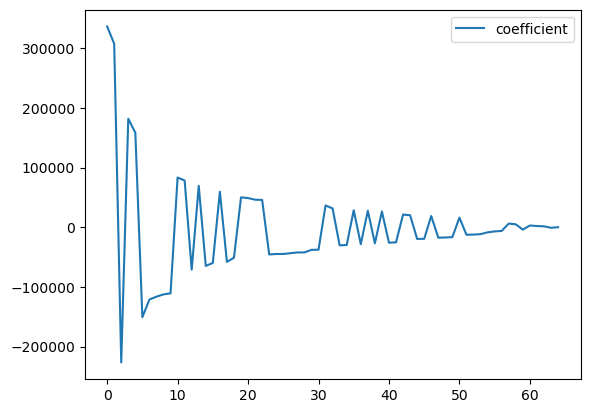

In [140]:
base_coef_df.plot()

# Add a title to the plot
ax.set_title('Relative Coefficient Strengths')
# Save the plot as a JPEG image
plt.savefig('base_coef_plot.jpg')

Baseline regression model shows the base model coefficients representing the change in the price variable given a change in the predictor variable. Regression coefficients indicate the strength and direction of the relationship between the independent variables and the dependent variable in a linear regression model. Specifically, they indicate the amount of change in the dependent variable (i.e., the predicted outcome) associated with a one-unit change in the independent variable while holding all other variables constant.
Seems like the strongest relationship between the variable and price is for the odometer reading, the colors black, blue, brown, custom, green, grey, orange, purple, red, sliver, white and yellow, and the age of the car. 
So Distance Driven, Color of the Car (with blue winning and black losing) and Age of the car. From a manufacturing perspective, the audis win out and the acuras have a negative relationship with car price. 

1	odometer	307394.727701
2	color_black	-226584.959477
3	color_blue	181640.742801
4	color_brown	158280.057086
5	color_custom	-150779.530133
6	color_green	-121112.679886
7	color_grey	-116319.747791
8	color_orange	-112549.679524
9	color_purple	-110755.102071
10	color_red	83232.541281
11	color_silver	78222.051493
12	color_white	-71161.619169
13	color_yellow	69179.303289
14	age	-64840.091449
15	manu__acura	-59803.138595
16	manu__audi	59492.418413
17	manu__bmw	-58005.391285
18	manu__buick	-51102.927111
19	manu__cadillac	50004.196532
20	manu__chevrolet	48766.065105

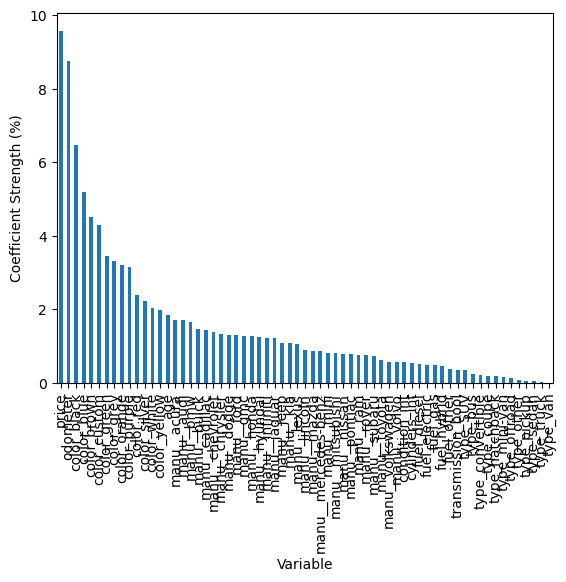

In [141]:
# Calculate the absolute value of coefficients
base_coef_df['abs_coef'] = abs(base_coef_df['coefficient'])

# Calculate the percentage of each coefficient relative to the sum of absolute coefficients
base_coef_df['coef_pct'] = base_coef_df['abs_coef'] / base_coef_df['abs_coef'].sum() * 100

# Sort the dataframe by coefficient percentage in descending order
base_coef_df = base_coef_df.sort_values(by='coef_pct', ascending=False)

# Create a bar plot of coefficient percentages
ax = base_coef_df.plot(kind='bar', x='Variable', y='coef_pct', legend=False)

# Set the y-axis label
ax.set_ylabel('Coefficient Strength (%)')

# Show the plot
plt.show()


The base model has a Mean Squared Error value of 1.22 

### Baseline- Linear Regression

In [142]:
# SETUP THE MODELING DATA
df = vehicles_trans.copy()
X = df.drop('price', axis = 1)
y = df['price']

#Create modeling train and test datasets using test_size = 0.3, random_state = 22
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=22)

print(X_train.shape)
print(X_test.shape)
print(type(X_train), type(y_train))#should be DataFrame and Series

(87385, 65)
(37451, 65)
<class 'pandas.core.frame.DataFrame'> <class 'pandas.core.series.Series'>


In [143]:
# MAKE BASELINE PREDICTIONS

baseline_train = np.ones(shape = y_train.shape)*y_train.mean()
baseline_test = np.ones(shape = y_test.shape)*y_test.mean()
mse_baseline_train = mean_squared_error(baseline_train, y_train)
mse_baseline_test = mean_squared_error(baseline_test, y_test)


# Answer check
print(baseline_train.shape, baseline_test.shape)
print(f'Baseline MSE for training data: {mse_baseline_train}')
print(f'Baseline MSE for testing data: {mse_baseline_test}')

(87385,) (37451,)
Baseline MSE for training data: 174284185275576.66
Baseline MSE for testing data: 502973780564.00995


In [144]:
highest_corr = df.corr()[['price']].nlargest(columns = 'price', n = 2).index[1]
### END SOLUTION

# Answer check
print(highest_corr)

type_pickup


This provides the MSE of the baseline predictions for the training and testing data, which can be used to compare against the MSE of more complex models to evaluate their performance.

In [165]:
# Instantiate Linear Regression model
lr_model1 = LinearRegression()

# Fit model to training data
lr_model1.fit(X_train, y_train)

# Run the Linear Regression model on training and testing data
lr_model1_train = lr_model1.predict(X_train)
lr_model1_test = lr_model1.predict(X_test)

# Calculate the MSE for the 
mse_lr_model1_train = mean_squared_error(lr_model1_train, y_train)
mse_lr_model1_test = mean_squared_error(lr_model1_test, y_test)

print(lr_model1_train.shape, lr_model1_test.shape)

print(f'Linear Regression1 Model MSE for training data: {mse_lr_model1_train}')
print(f'Linear Regression1 Model MSE for testing data: {mse_lr_model1_test}')

(87385,) (37451,)
Linear Regression1 Model MSE for training data: 174216277615694.47
Linear Regression1 Model MSE for testing data: 574359849335.4742


### Simple 1 Variable Linear Regression Model

In [146]:
# Using the variable with the largest correlation factor 'type_pickup'

In [148]:
X1 = X_train[['type_pickup']]
lr = LinearRegression().fit(X1, y_train)
simple_1_coefs = lr.coef_
simple_1_pred = lr.predict(X_test[['type_pickup']])
simple_1_train_mse = mean_squared_error(y_train, lr.predict(X1))
simple_1_test_mse = mean_squared_error(y_test, lr.predict(X_test[['type_pickup']]))

# Print Model's coefficients
print(type(simple_1_coefs))
print(simple_1_coefs)
# Print Model's MSEs
print(f'Simple 1 Variable LR Train MSE: {simple_1_train_mse: .2f}')
print(f'Simple 1 Variable LR Test MSE: {simple_1_test_mse: .2f}')

<class 'numpy.ndarray'>
[425599.45427003]
Simple 1 Variable LR Train MSE:  174262826351238.03
Simple 1 Variable LR Test MSE:  526836650998.27


### Lasso Grid Search Regression  & Polynomial Features degree 1

In [149]:
# build a Pipeline using Polynomial Features to degree2, a StandardScaler, and the Lasso Regression
car_pipe = Pipeline([('polyfeatures', PolynomialFeatures(degree = 1
                                                         , include_bias = False)),
                      ('scaler', StandardScaler()),
                     ('lasso', Lasso(random_state = 42))])
car_pipe.fit(X_train, y_train)
lasso_coefs = car_pipe.named_steps['lasso'].coef_
### END SOLUTION

print(type(lasso_coefs))
print(lasso_coefs)
car_pipe

<class 'numpy.ndarray'>
[ 6.21186261e+03 -1.94840604e+04 -1.55485195e+04 -1.72232784e+04
 -1.08247513e+04 -1.76419455e+04 -2.06146810e+04 -2.77498130e+03
 -1.90589610e+03 -2.87848476e+04  7.77551686e+04 -1.28877807e+04
 -5.01577222e+03  2.35356526e+04 -7.21038692e+02 -1.21010491e+03
 -1.40834594e+04  9.14829534e+03 -1.27222800e+04 -6.65434474e+04
 -2.70821918e+03 -1.07631357e+04 -4.53501716e+04 -5.20240284e+04
  3.21374826e+03  1.18767138e+03 -1.50802656e+02 -4.00901687e+03
  7.74998601e+02  4.78806382e+03 -8.63563119e+03 -5.22181486e+03
  5.90531598e+03 -2.13939964e+04  5.99094582e+03  2.89928846e+03
 -1.51959325e+04 -8.60495776e+03 -6.84716444e+04 -4.73989155e+03
  9.93236215e+03  1.15840973e+05  2.54411385e+03 -3.28237866e+03
 -4.39880129e+04  1.00686926e+05  5.68749559e+04  3.57168811e+02
  1.29077238e+04 -1.56559701e+04 -5.91940962e+03 -6.69352074e+04
 -3.69533813e+04 -4.09639032e+03 -9.02620780e+03  1.97724565e+03
 -4.70575949e+03 -2.96820249e+04 -6.71609019e+03  8.08122212e+03
 

Pipeline(steps=[('polyfeatures',
                 PolynomialFeatures(degree=1, include_bias=False)),
                ('scaler', StandardScaler()),
                ('lasso', Lasso(random_state=42))])

In [150]:
# define the model predictions 
lasso_train_pred = car_pipe.predict(X_train)
lasso_test_pred = car_pipe.predict(X_test)

# compute the MSE on the lasso model on both train and test data
lasso_train_mse = mean_squared_error(y_train, car_pipe.predict(X_train))
lasso_test_mse = mean_squared_error(y_test, car_pipe.predict(X_test))
### END SOLUTION

# Print model's MSEs
print(f'Lasso Train MSE: {lasso_train_mse: .2f}')
print(f'Lasso Test MSE: {lasso_test_mse: .2f}')

Lasso Train MSE:  174216277615763.41
Lasso Test MSE:  574357495963.27


### SequentialFeature Selection & Polynomial Features degree 1

Build a Pipeline using Polynomial Features to degree 1, SEquential Feature Selector with Linear Regression and 15 features

In [152]:
sequential_pipe = Pipeline([('poly_features', PolynomialFeatures(degree = 1, include_bias = False)),
                           ('selector', SequentialFeatureSelector(LinearRegression(), 
                                                                  n_features_to_select=15)),
                           ('linreg', LinearRegression())])
sequential_pipe.fit(X_train, y_train)



Pipeline(steps=[('poly_features',
                 PolynomialFeatures(degree=1, include_bias=False)),
                ('selector',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select=15)),
                ('linreg', LinearRegression())])

In [153]:
sfs_train_pred = sequential_pipe.predict(X_train)
sfs_test_pred =  sequential_pipe.predict(X_test)
sequential_train_mse = mean_squared_error(y_train, sfs_train_pred)
sequential_test_mse = mean_squared_error(y_test, sfs_test_pred)
sfs_coefs = sequential_pipe.named_steps['linreg'].coef_

In [154]:
# Print model coefficients
print(sfs_coefs)

# Print model's MSEs
print(f'Sequential Feature Selection Train MSE: {sequential_train_mse: .2f}')
print(f'Sequential Feature Selection Test MSE: {sequential_test_mse: .2f}')
sequential_pipe

[-57000.3755792  -65591.3715613   -1713.6580571  -59758.67878574
  38272.15804774  17129.4577873  -55552.77937907 -66749.29958204
 -63439.72090767 -61395.50753933 -50473.82965226 -65051.69906211
 -51913.47988697 -68775.42220555 -54881.17070159]
Sequential Feature Selection Train MSE:  174283897158919.31
Sequential Feature Selection Test MSE:  506132142897.39


Pipeline(steps=[('poly_features',
                 PolynomialFeatures(degree=1, include_bias=False)),
                ('selector',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select=15)),
                ('linreg', LinearRegression())])

## SequentialFeature Selection & Polynomial Features degree 2

In [ ]:
sequential_pipe2 = Pipeline([('poly_features', PolynomialFeatures(degree = 2, include_bias = False)),
                           ('selector', SequentialFeatureSelector(LinearRegression(), 
                                                                  n_features_to_select=15)),
                           ('linreg', LinearRegression())])
sequential_pipe2.fit(X_train, y_train)

In [167]:
sfs_train_pred2 = sequential_pipe.predict(X_train)
sfs_test_pred2 =  sequential_pipe.predict(X_test)
sequential_train_mse2 = mean_squared_error(y_train, sfs_train_pred)
sequential_test_mse2 = mean_squared_error(y_test, sfs_test_pred)
sfs_coefs2 = sequential_pipe.named_steps['linreg'].coef_

In [168]:
# Print model coefficients
print(sfs_coefs2)

# Print model's MSEs
print(f'Sequential Feature Selection Train MSE: {sequential_train_mse2: .2f}')
print(f'Sequential Feature Selection Test MSE: {sequential_test_mse2: .2f}')
sequential_pipe2

[-57000.3755792  -65591.3715613   -1713.6580571  -59758.67878574
  38272.15804774  17129.4577873  -55552.77937907 -66749.29958204
 -63439.72090767 -61395.50753933 -50473.82965226 -65051.69906211
 -51913.47988697 -68775.42220555 -54881.17070159]
Sequential Feature Selection Train MSE:  174283897158919.31
Sequential Feature Selection Test MSE:  506132142897.39


Pipeline(steps=[('poly_features', PolynomialFeatures(include_bias=False)),
                ('selector',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select=15)),
                ('linreg', LinearRegression())])

### Lasso Feature Selection & Polynomial Features degree 1

In [ ]:
lasso_selector_pipe = Pipeline([('poly_features', PolynomialFeatures(degree = 1, include_bias = False)),
                                ('scaler', StandardScaler()),
                                ('selector', SelectFromModel(Lasso())),
                                    ('linreg', LinearRegression())])

lasso_selector_pipe.fit(X_train, y_train)

lasso_selector_train_pred = lasso_selector_pipe.predict(X_train)
lasso_selector_test_pred = lasso_selector_pipe.predict(X_test)

lasso_selector_train_mse = mean_squared_error(y_train, lasso_selector_train_pred)
lasso_selector_test_mse = mean_squared_error(y_test, lasso_selector_test_pred)

lasso_selector_coefs = lasso_selector_pipe.named_steps['linreg'].coef_



In [159]:
# Print model coefficients
print(lasso_selector_coefs)

# Print model's MSEs
print(f'Sequential Feature Selection Train MSE: {lasso_selector_train_mse: .2f}')
print(f'Sequential Feature Selection Test MSE: {lasso_selector_test_mse: .2f}')
lasso_selector_pipe

[ 5.48406214e+03 -1.05110616e+19 -8.16451312e+18 -4.43964343e+18
 -3.77193498e+18 -4.47940197e+18 -8.00603584e+18 -1.96194987e+18
 -1.35877988e+18 -8.16412691e+18 -9.35564992e+18 -1.14169610e+19
 -2.29281933e+18  2.66240000e+04 -3.06189551e+17 -3.24672751e+17
 -4.15734145e+17 -3.00702985e+17 -3.08033656e+17 -9.06077779e+17
 -3.25756998e+17 -4.65547548e+17 -9.57214690e+17 -5.38965259e+17
 -5.86938146e+17 -3.67080950e+17 -3.12480206e+17 -1.50631905e+17
 -5.33853528e+17 -3.23693603e+17 -3.55072272e+17 -2.66072105e+17
 -2.62833742e+17 -4.07774876e+17 -1.67041989e+17 -2.12474453e+17
 -5.59894731e+17 -2.23199991e+17 -4.94038520e+17 -1.65300410e+17
 -3.80600334e+17 -7.13592797e+17 -3.67080950e+17 -2.06983874e+17
 -4.71040000e+04  1.00992000e+05  4.33057088e+18  4.39202504e+17
  5.46602162e+18  2.06217961e+18  2.85764179e+18 -7.06560000e+04
  1.12344911e+19  1.01135190e+18  4.31089623e+18  6.77521508e+18
  4.94142401e+18  3.94558848e+18  1.68290218e+18  5.57526197e+18
  9.18893545e+18  1.17053

Pipeline(steps=[('poly_features',
                 PolynomialFeatures(degree=1, include_bias=False)),
                ('scaler', StandardScaler()),
                ('selector', SelectFromModel(estimator=Lasso())),
                ('linreg', LinearRegression())])

## Lasso Feature Selection & Polynomial Features degree 2

In [160]:
lasso_selector_pipe2 = Pipeline([('poly_features', PolynomialFeatures(degree = 2, include_bias = False)),
                                ('scaler', StandardScaler()),
                                ('selector', SelectFromModel(Lasso())),
                                    ('linreg', LinearRegression())])

lasso_selector_pipe2.fit(X_train, y_train)

lasso_selector_train_pred2 = lasso_selector_pipe2.predict(X_train)
lasso_selector_test_pred2 = lasso_selector_pipe2.predict(X_test)

lasso_selector_train_mse2 = mean_squared_error(y_train, lasso_selector_train_pred2)
lasso_selector_test_mse2 = mean_squared_error(y_test, lasso_selector_test_pred2)

lasso_selector_coefs2 = lasso_selector_pipe2.named_steps['linreg'].coef_


In [161]:
# Print model coefficients
print(lasso_selector_coefs2)

# Print model's MSEs
print(f'Sequential Feature Selection Train MSE: {lasso_selector_train_mse2: .2f}')
print(f'Sequential Feature Selection Test MSE: {lasso_selector_test_mse2: .2f}')
lasso_selector_pipe2

[ 1.63357459e+18 -3.40276330e+18 -4.69816655e+18 ... -1.02606750e+19
  4.48384238e+18 -4.63071123e+18]
Sequential Feature Selection Train MSE:  173758908873044.62
Sequential Feature Selection Test MSE:  11673381661986162487824668807720337408.00


Pipeline(steps=[('poly_features', PolynomialFeatures(include_bias=False)),
                ('scaler', StandardScaler()),
                ('selector', SelectFromModel(estimator=Lasso())),
                ('linreg', LinearRegression())])

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

## COMPARE THE MODELS

In [ ]:
# compare the test predictios for all models:
# create a dictionary with the actual y_test values and predictions from each model
test_prediction_data = {'actual': y_test, 
                        'Base LR1 - All Variables': lr_model1_test, 
                        'Simple LR - 1 Variable': simple_1_pred, 
                        'Lasso Regression': lasso_test_pred, 
                        'SFS LR': sfs_test_pred,
                        'SFS LR 2nd Degree': sfs_test_pred2,
                       'Lasso Selection LR': lasso_selector_test_pred,
                       'Lasso Selection LR 2nd Degree':lasso_selector_test_pred2 }

# set the float format to display full numbers
pd.options.display.float_format = '{:.2f}'.format

# create a dataframe using the dictionary
test_prediction_dataframe = pd.DataFrame(test_prediction_data)

# display the dataframe
print(test_prediction_dataframe)

None of the models are doing a good job at all at predicting the used car sales price - the best feature selection option seems to be Sequential Feature Selection

This seems in line with the correlation matrix visualizations early on - that didn't seem to show strong correlation on price.

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

### Findings/TakeAways: 
--- The sale of used PickUp trucks seem to strongly affect the 'price' - so definitely focus on acquiring pickup trucks for the inventory

##### Regression coefficients 
Regression coefficients indicate the strength and direction of the relationship between the independent variables and the dependent variable  in a linear regression model. 
Specifically, they indicate the amount of change in the dependent variable (i.e., the predicted outcome) associated  with a one-unit change in the independent variable while holding all other variables constant.
Seems like the strongest relationship between the  variable and price is for the odometer reading, the colors black, blue, brown, custom, green, grey, orange, purple, red, sliver, white and yellow, 
and the age of the car. 

##### --- Key Drivers of Used Car Sales: 
DISTANCE DRIVEN ('odometer'), 
CAR COLOR (with blue winning and black losing) 
CAR AGE:derived from the year, customer care about how old the car is and how much life is left in it.    Most customers are comfortable buying 5-6 year old cars.
MANUFACTURER: From a manufacturing perspective, the audis win out and the acuras have a negative relationship with car price.

## NEXT STEPS

There were too many nulls in the dataset so a lot of very valuable information was lost.  More time should be spent both 1) cleaning up the data and obtaining the values for all the null values. 2) running more feature selection methods to help determine the best possible feature set. 